In [11]:
from birdclassification.preprocessing.augmentations import BandPass, AddWhiteNoise
import torchaudio
from birdclassification.visualization.plots import plot_torch_waveform
from noisereduce.torchgate import TorchGate as TG

### Original audio

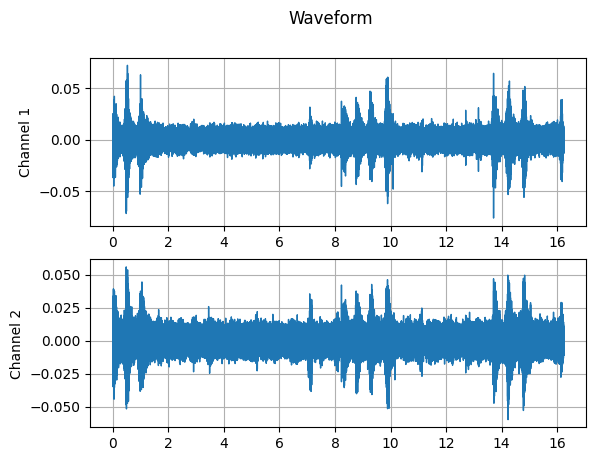

In [12]:
signal, sr = torchaudio.load('../test_recordings/XC828343 - Tawny Owl - Strix aluco.wav')
plot_torch_waveform(signal, sr)

### Bandpass

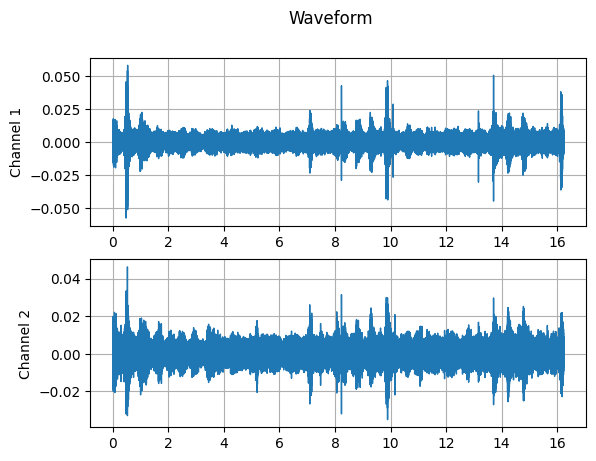

In [13]:
bandpass = BandPass(sr, 10000)
filtered = bandpass(signal)
plot_torch_waveform(filtered, sr)

### Noise reduction

In [14]:
reduce_noise_non = TG(sr, nonstationary=True)
reduce_noise = TG(sr, nonstationary=False)
add_noise = AddWhiteNoise(min_factor=0.1, max_factor=0.8)

### Noise reduction - Nonstationary

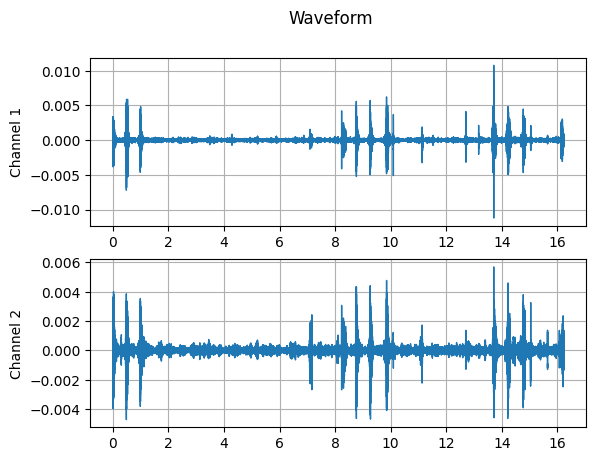

In [15]:
reduced_non = reduce_noise_non(signal)
plot_torch_waveform(reduced_non, sr)

### Noise reduction - Stationary

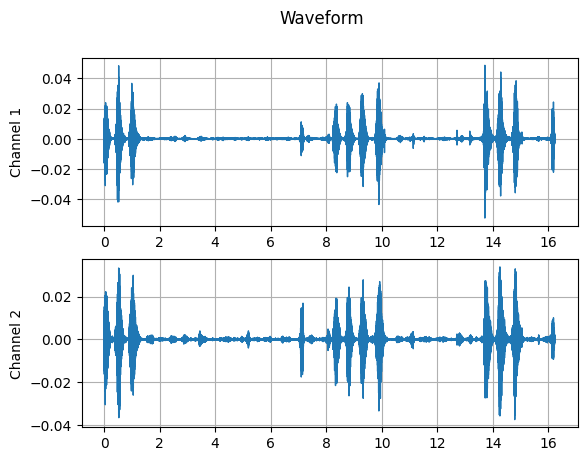

In [16]:
reduced = reduce_noise(signal)
plot_torch_waveform(reduced, sr)

### Adding white noise, then noise reduction

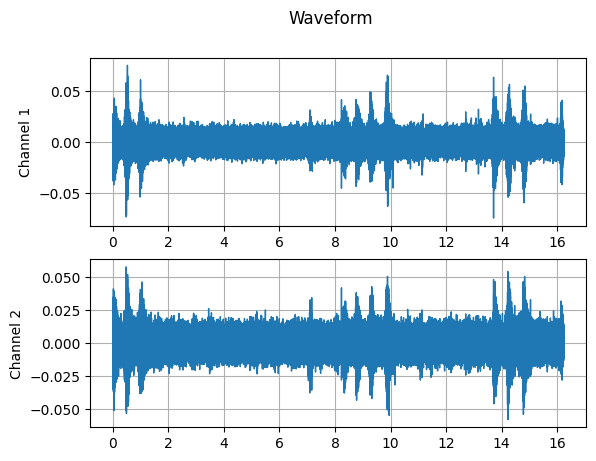

In [17]:
noisy = add_noise(signal)
plot_torch_waveform(noisy, sr)

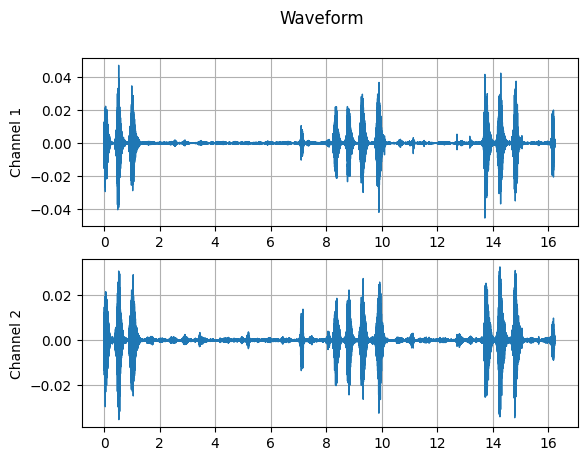

In [18]:
reduced = reduce_noise(noisy)
plot_torch_waveform(reduced, sr)